In [24]:
import boto3
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from umap import UMAP
from pyqtree import Index
import matplotlib.offsetbox as offsetbox
import random
from huggingface_hub import from_pretrained_keras
import csv

s3 = boto3.resource('s3')
bucket_name = 'dalle2images'

# Define the image size for the RestNet model
# image_size = (224, 224)
image_size = (180, 180)
# # Define the scale factor and border thickness for displaying the images in the UMAP plot
# scale_factor = 0.1
# border_thickness = 5


In [25]:
# model = from_pretrained_keras("poojakabber1997/ResNetDallE2Fake")
model = from_pretrained_keras("poojakabber1997/ResNetDallE2Fakes")

# Load the image paths from your S3 bucket
image_paths = [obj.key for obj in s3.Bucket(bucket_name).objects.all() if obj.key.endswith('.png')]

real_image_paths = [path for path in image_paths if path.startswith('real')]
fake_image_paths = [path for path in image_paths if path.startswith('fake')]

# Select a random sample of images
n_samples = 300
n_real = n_fake = n_samples // 2

real_samples = random.sample(real_image_paths, n_real)
fake_samples = random.sample(fake_image_paths, n_fake)

image_paths = real_samples + fake_samples
test_labels = [0] * n_real + [1] * n_fake  # Add this line to create the test_labels list

config.json not found in HuggingFace Hub.


Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

In [26]:

# Select the first 300 images
image_paths = image_paths[:300]

# Load the selected images from S3 and preprocess them for the RestNet model
test_images = []
for path in image_paths:
    img_obj = s3.Object(bucket_name, path)
    img = Image.open(img_obj.get()['Body'])
    img = img.resize(image_size, Image.ANTIALIAS)
    img = np.array(img)
    img = img / 255.0
    test_images.append(img)


test_images = np.stack(test_images)
test_orig_images = (test_images * 255).astype(np.uint8)  # Convert the test_images back to the original format


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_65032/65510515.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img = img.resize(image_size, Image.ANTIALIAS)


In [54]:
# Create a custom model to extract features from the original model
# Assuming you want to extract features from the last layer before the output layer
feature_layer_index = -2

feature_extractor_model = tf.keras.Model(inputs=model.input, outputs=model.layers[feature_layer_index].output)
layer_outputs = [layer.output for layer in feature_extractor_model.layers]
feature_map_model = tf.keras.models.Model(inputs=feature_extractor_model.input, outputs=layer_outputs)
feature_maps = feature_map_model.predict(X)

ValueError: Graph disconnected: cannot obtain value for tensor KerasTensor(type_spec=TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float32, name='input_1'), name='input_1', description="created by layer 'input_1'") at layer "conv1_pad". The following previous layers were accessed without issue: []

In [28]:
# Extract the features from the custom model for UMAP visualization
features = feature_extractor_model.predict(test_images)


umap = UMAP(n_components=2, random_state=42)
umap_features = umap.fit_transform(features)
umap_scaling_factor = 30  # Increase this value to increase the distance between points
umap_features = umap_features * umap_scaling_factor


10/10 [==============================] - 5s 318ms/step


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_65032/1471256733.py:21: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


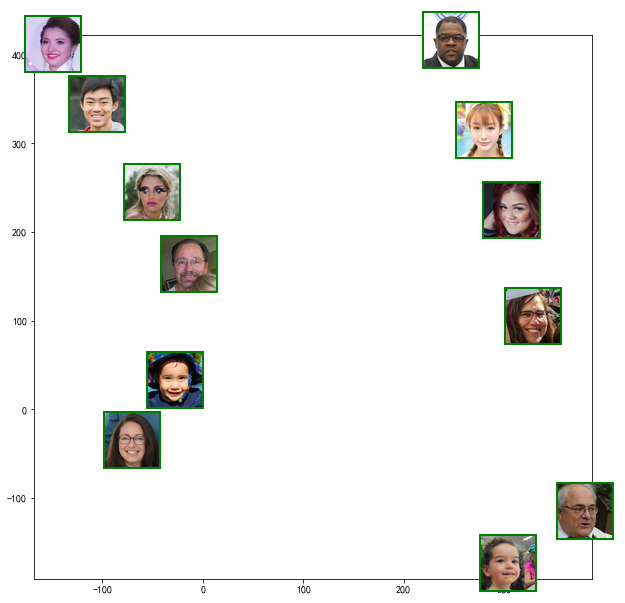

In [12]:
# Plot the results using RestNet
# Define the scale factor and border thickness for displaying the images in the UMAP plot
scale_factor = 0.3
border_thickness = 2


fig, ax = plt.subplots(figsize=(10, 10))

# Initialize the QuadTree with a bounding box covering the entire UMAP features range
bbox = (umap_features[:, 0].min(), umap_features[:, 1].min(), umap_features[:, 0].max(), umap_features[:, 1].max())
quadtree = Index(bbox)

# Add a padding factor to increase the space between images
padding_factor = 1.2
used_images_info = []
# Loop through the UMAP features
for i, (x, y) in enumerate(umap_features):
    img = test_orig_images[i]

    # Resize the image
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if test_labels[i] == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))


    # Create the bounding box for the image and check for collisions in the QuadTree
    half_width = img_resized.width / 2 * padding_factor
    half_height = img_resized.height / 2 * padding_factor
    image_bbox = (x - half_width, y - half_height, x + half_width, y + half_height)

    # If there are no collisions, insert the image into the QuadTree and add the image to the plot
    if not quadtree.intersect(image_bbox):
        quadtree.insert(item=i, bbox=image_bbox)
        imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
        ax.add_artist(imagebox)
        used_images_info.append((image_paths[i], test_labels[i]))  # Save the image filename and label


# Write the used image filenames and labels to a CSV file
with open("used_images.csv", "w", newline="") as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(["filename", "label"])
    writer.writerows(used_images_info)
    
# Set the plot limits and display the plot
ax.set_xlim(umap_features[:, 0].min() - 5, umap_features[:, 0].max() + 5)
ax.set_ylim(umap_features[:, 1].min() - 5, umap_features[:, 1].max() + 5)
plt.show()

/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_65032/477331392.py:63: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


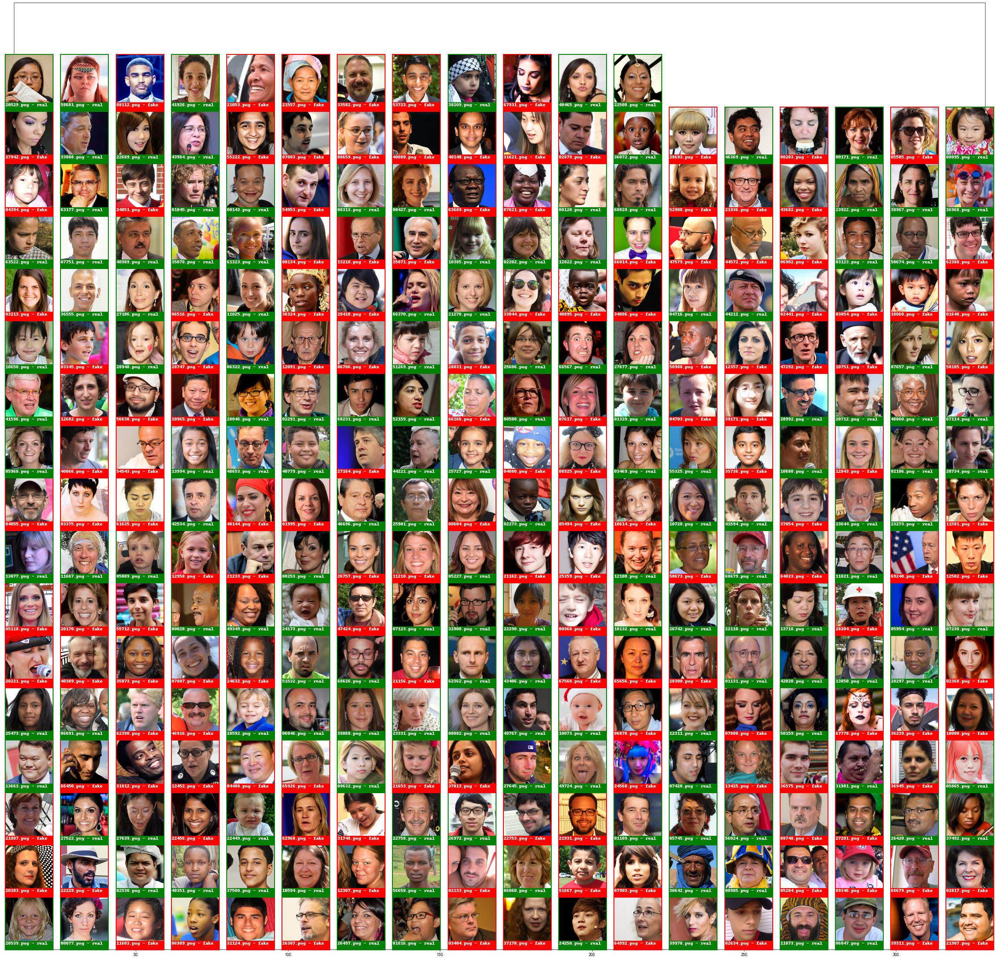

In [29]:
import numpy as np
from pyqtree import Index
import matplotlib.pyplot as plt
import matplotlib.offsetbox as offsetbox
import os
from PIL import Image, ImageDraw
import csv

fig, ax = plt.subplots(figsize=(40, 40))

# Define the scale factor and border thickness for displaying the images in the UMAP plot
scale_factor = 0.6
border_thickness = 2

# Sort the images by their UMAP coordinates
sorted_indices = np.lexsort((umap_features[:, 1], umap_features[:, 0]))

# Initialize a list to store the image filenames and labels
image_data = []

# Calculate the number of rows and columns for the grid
n_rows = int(np.ceil(np.sqrt(len(umap_features))))
n_columns = n_rows

# Calculate the range of x and y coordinates
x_range = umap_features[:, 0].max() - umap_features[:, 0].min()
y_range = umap_features[:, 1].max() - umap_features[:, 1].min()

# Calculate the spacing between images in the grid
x_spacing = x_range / (n_columns - 1)
y_spacing = y_range / (n_rows - 1)

# Initialize the grid
grid = np.zeros((n_rows, n_columns))

# Loop through the sorted images and place them in the grid
for i, index in enumerate(sorted_indices):
    # Get the filename and label for the current image
    filename = os.path.basename(image_paths[index])
    label = test_labels[index]

    # Add the image data to the list
    image_data.append([filename, label])
    
    row = i // n_columns
    column = i % n_columns

    # Calculate the x and y coordinates for the current image
    x = umap_features[:, 0].min() + column * x_spacing
    y = umap_features[:, 1].min() + row * y_spacing

    # Load and resize the image
    img = test_orig_images[index]

    # Get the filename and label for the current image
    filename = os.path.basename(image_paths[index])
    label = test_labels[index]

    # Create the border text
    border_text = f"{filename} - {'fake' if label == 1 else 'real'}"

    # Create the bordered image with text
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    # Add the image to the plot
    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Save the image filenames and labels to a CSV file
csv_filename = "image_filenames.csv"
with open(csv_filename, mode="w", newline="") as csvfile:
    csv_writer = csv.writer(csvfile)
    csv_writer.writerow(["image_filename", "label"])
    csv_writer.writerows(image_data)

# Set the plot limits and display the plot
ax.set_xlim(umap_features[:, 0].min() - 5, umap_features[:, 0].max() + 5)
ax.set_ylim(umap_features[:, 1].min() - 5, umap_features[:, 1].max() + 5)
plt.show()


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_65032/3586040081.py:73: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


(104.28112030029297, 274.2723388671875)

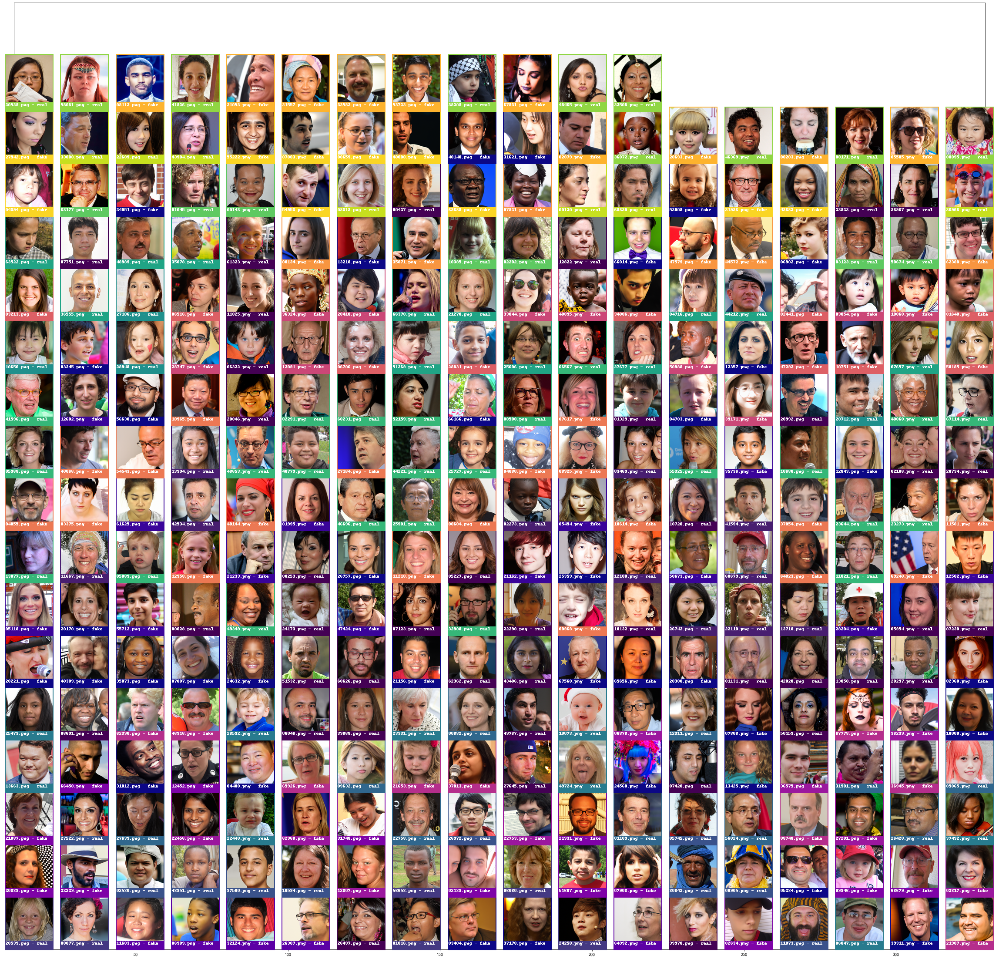

In [30]:
import numpy as np
from pyqtree import Index
import matplotlib.pyplot as plt
import matplotlib.offsetbox as offsetbox
import os
from PIL import Image, ImageDraw
import csv
import hdbscan

# Cluster the UMAP features using HDBSCAN
clusterer = hdbscan.HDBSCAN(min_cluster_size=10, min_samples=5)
cluster_labels = clusterer.fit_predict(umap_features)

fig, ax = plt.subplots(figsize=(40, 40))
# Define the scale factor and border thickness for displaying the images in the UMAP plot
scale_factor = 0.6
border_thickness = 2

# Sort the images by their UMAP coordinates
sorted_indices = np.lexsort((umap_features[:, 1], umap_features[:, 0]))

# Initialize a list to store the image filenames and labels
image_data = []

# Calculate the number of rows and columns for the grid
n_rows = int(np.ceil(np.sqrt(len(umap_features))))
n_columns = n_rows

# Calculate the range of x and y coordinates
x_range = umap_features[:, 0].max() - umap_features[:, 0].min()
y_range = umap_features[:, 1].max() - umap_features[:, 1].min()

# Calculate the spacing between images in the grid
x_spacing = x_range / (n_columns - 1)
y_spacing = y_range / (n_rows - 1)

# Initialize the grid
grid = np.zeros((n_rows, n_columns))

# Define separate colors for real and fake images
colors_real = plt.cm.get_cmap('viridis', len(np.unique(cluster_labels)))
colors_fake = plt.cm.get_cmap('plasma', len(np.unique(cluster_labels)))


# Loop through the sorted images and place them in the grid
# Loop through the sorted images and place them in the grid
for i, index in enumerate(sorted_indices):
    # Get the filename and label for the current image
    filename = os.path.basename(image_paths[index])
    label = test_labels[index]

    # Add the image data to the list
    image_data.append([filename, label])
    
    row = i // n_columns
    column = i % n_columns

    # Calculate the x and y coordinates for the current image
    x = umap_features[:, 0].min() + column * x_spacing
    y = umap_features[:, 1].min() + row * y_spacing

    # Load and resize the image
    img = test_orig_images[index]

    # Get the filename and label for the current image
    filename = os.path.basename(image_paths[index])
    label = test_labels[index]

    # Create the border text
    border_text = f"{filename} - {'fake' if label == 1 else 'real'}"

    # Create the bordered image with text
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    # Change the border color according to the cluster label
        # Change the border color according to the cluster label and real/fake status
    if label == 0:  # Real
        border_color = tuple(int(c * 255) for c in colors_real(cluster_labels[index])[:3])
    else:  # Fake
        border_color = tuple(int(c * 255) for c in colors_fake(cluster_labels[index])[:3])


    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    # Add the image to the plot
    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Save the image filenames and labels to a CSV file
csv_filename = "image_filenames.csv"
with open(csv_filename, mode="w", newline="") as csvfile:
    csv_writer = csv.writer(csvfile)
    csv_writer.writerow(["image_filename", "label"])
    csv_writer.writerows(image_data)

# Set the plot limits and display the plot
ax.set_xlim(umap_features[:, 0].min() - 5, umap_features[:, 0].max() + 5)
ax.set_ylim(umap_features[:, 1].min() - 5, umap_features[:, 1].max() + 5)


# Feature without change

In [26]:
import boto3
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from pyqtree import Index
import matplotlib.offsetbox as offsetbox
import random
from huggingface_hub import from_pretrained_keras
import csv
import os
from PIL import ImageDraw
s3 = boto3.resource('s3')
bucket_name = 'dalle2images'

image_size = (180, 180)
model = from_pretrained_keras("poojakabber1997/ResNetDallE2Fakes")


config.json not found in HuggingFace Hub.


Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

In [27]:

image_paths = [obj.key for obj in s3.Bucket(bucket_name).objects.all() if obj.key.endswith('.png')]

real_image_paths = [path for path in image_paths if path.startswith('real')]
fake_image_paths = [path for path in image_paths if path.startswith('fake')]

n_samples = 306
n_real = n_fake = n_samples // 2

real_samples = random.sample(real_image_paths, n_real)
fake_samples = random.sample(fake_image_paths, n_fake)

image_paths = real_samples + fake_samples
test_labels = [0] * n_real + [1] * n_fake

In [28]:
test_images = []
for path in image_paths:
    img_obj = s3.Object(bucket_name, path)
    img = Image.open(img_obj.get()['Body'])
    img = img.resize(image_size, Image.ANTIALIAS)
    img = np.array(img)
    img = img / 255.0
    test_images.append(img)

test_images = np.stack(test_images)
test_orig_images = (test_images * 255).astype(np.uint8)

feature_layer_index = -2
feature_extractor_model = tf.keras.Model(inputs=model.input, outputs=model.layers[feature_layer_index].output)
features = feature_extractor_model.predict(test_images)


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/1104284877.py:5: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img = img.resize(image_size, Image.ANTIALIAS)


10/10 [==============================] - 3s 213ms/step


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/2277808980.py:15: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


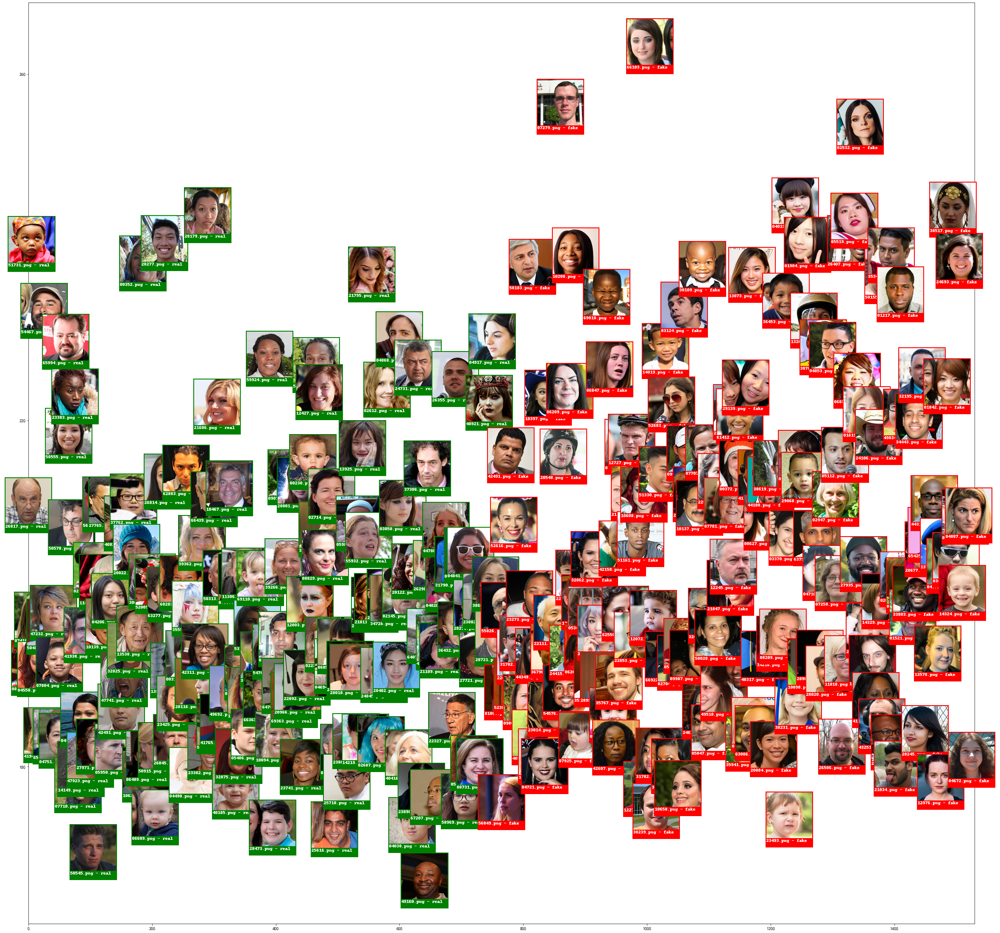

In [40]:
fig, ax = plt.subplots(figsize=(40, 40))

scale_factor = 0.6
border_thickness = 2
separation_distance = 5

for i, (feature, label, orig_image) in enumerate(zip(features, test_labels, test_orig_images)):
    y = feature[1] * 100
    x = i * separation_distance if label == 0 else (i - n_real) * separation_distance + n_real * separation_distance
    
    img = orig_image
    filename = os.path.basename(image_paths[i])
    
    border_text = f"{filename} - {'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")
    
    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

ax.set_xlim(0, (n_real + n_fake) * separation_distance)
ax.set_ylim(features[:, 1].min() * 100 - 5, features[:, 1].max() * 100 + 5)
plt.show()


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/3083452981.py:32: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


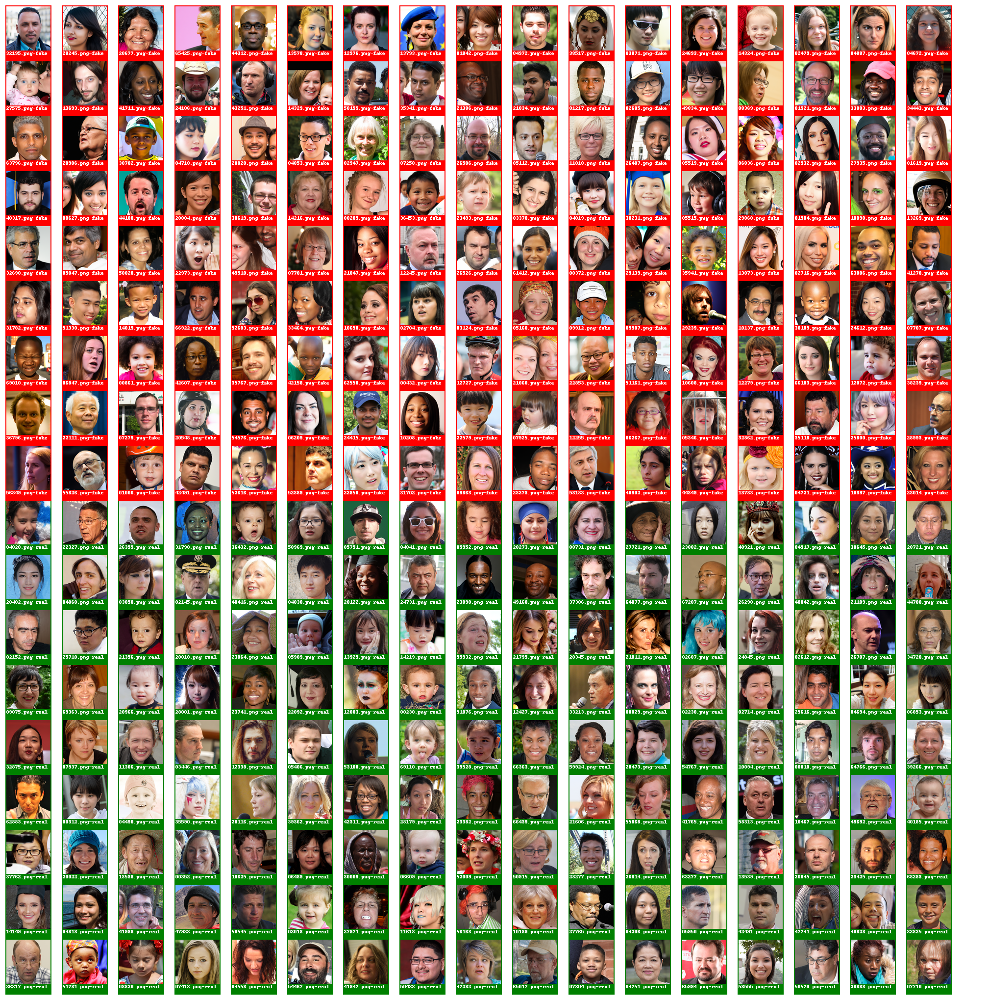

In [39]:
import matplotlib.pyplot as plt
import matplotlib.offsetbox as offsetbox
import matplotlib.image as mpimg
from PIL import Image, ImageDraw
import os
import math

# Create the figure and axes objects
fig, ax = plt.subplots(figsize=(35, 35))

# Set the figure background to transparent
fig.patch.set_alpha(0)

# Remove the x and y axis
ax.axis('off')

# Set the scale factor, border thickness and grid size
scale_factor = 0.5
border_thickness = 2
grid_size = int(math.sqrt(len(features)))

# Loop through the features, labels and images
for i, (feature, label, orig_image) in enumerate(zip(features, test_labels, test_orig_images)):
    row = i // grid_size
    col = i % grid_size
    x, y = col * 200, row * 200
    
    img = orig_image
    filename = os.path.basename(image_paths[i])
    
    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")
    
    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Set the x and y limits
ax.set_xlim(0, grid_size * 200)
ax.set_ylim(0, grid_size * 200)

# Show the plot
plt.show()


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/3520307444.py:25: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


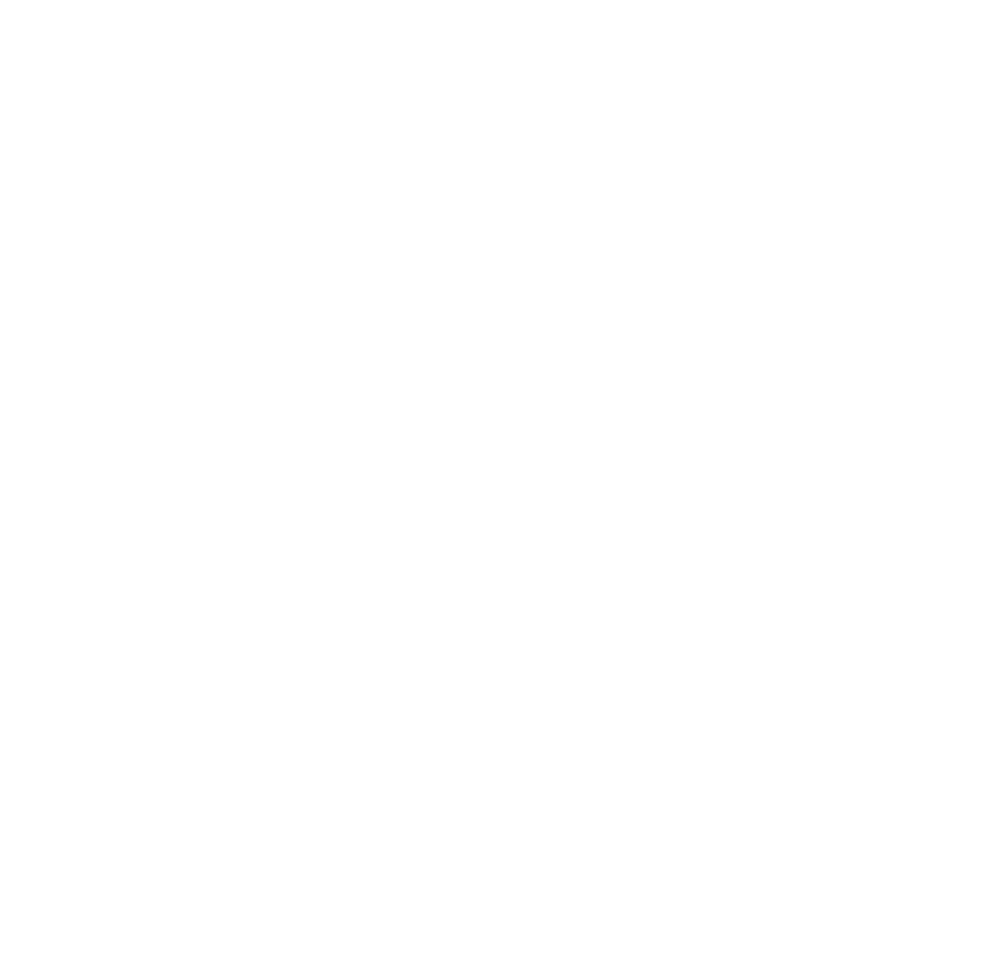

In [45]:
import umap
# Create a new figure and axes objects for the updated plot

embedding = reducer.fit_transform(features)

# Normalize the coordinates between 0 and 1
normalized_embedding = (embedding - embedding.min(axis=0)) / (embedding.max(axis=0) - embedding.min(axis=0))
fig, ax = plt.subplots(figsize=(35, 35))

# Set the figure background to transparent
fig.patch.set_alpha(0)

# Remove the x and y axis
ax.axis('off')
# Use UMAP to reduce the dimensionality of the features
reducer = umap.UMAP()
# Loop through the normalized_embedding, labels, and images
for i, (coord, label, orig_image) in enumerate(zip(normalized_embedding, test_labels, test_orig_images)):
    x, y = coord[0] * (grid_size * 200), coord[1] * (grid_size * 200)

    img = orig_image
    filename = os.path.basename(image_paths[i])

    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Show the plot
plt.show()


In [46]:
from sklearn.manifold import TSNE

# Use t-SNE to reduce the dimensionality of the features
tsne = TSNE(n_components=2, random_state=42)
embedding = tsne.fit_transform(features)

# Normalize the coordinates between 0 and 1
normalized_embedding = (embedding - embedding.min(axis=0)) / (embedding.max(axis=0) - embedding.min(axis=0))


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/3531047566.py:18: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


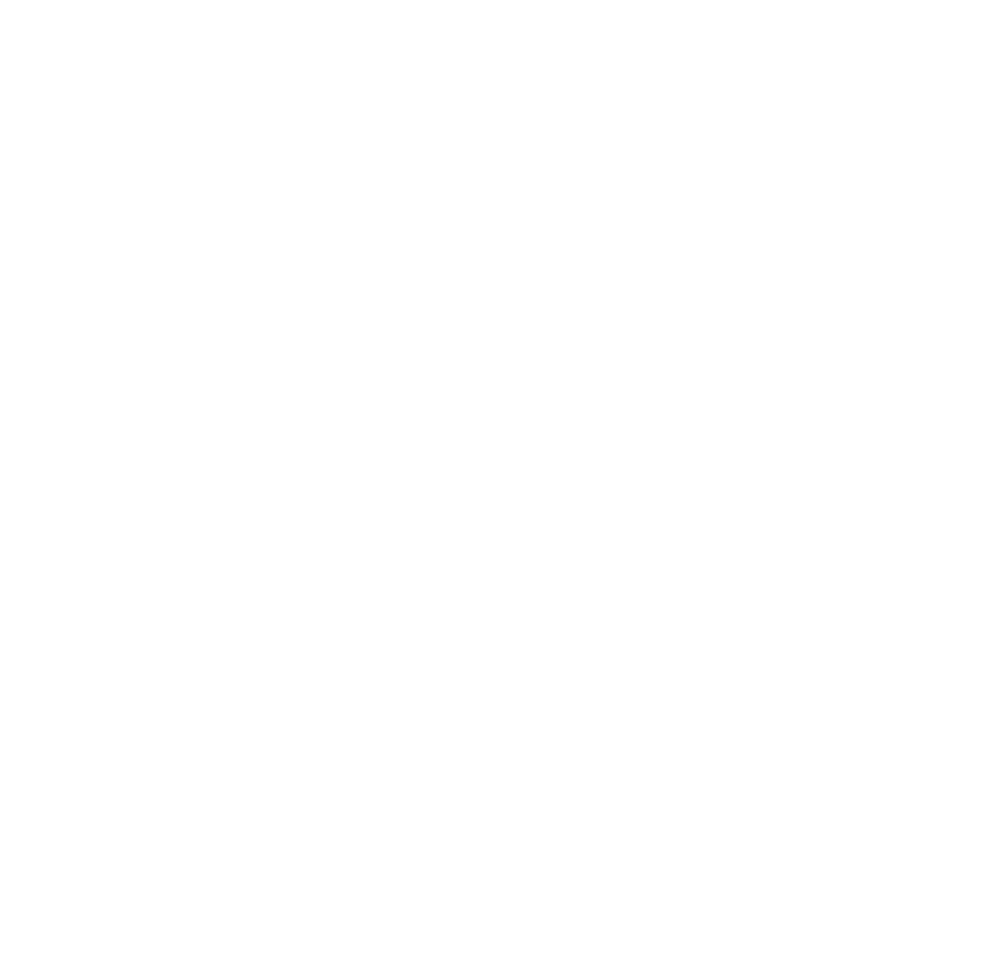

In [47]:
fig, ax = plt.subplots(figsize=(35, 35))

# Set the figure background to transparent
fig.patch.set_alpha(0)

# Remove the x and y axis
ax.axis('off')
# Use UMAP to reduce the dimensionality of the features
reducer = umap.UMAP()
# Loop through the normalized_embedding, labels, and images
for i, (coord, label, orig_image) in enumerate(zip(normalized_embedding, test_labels, test_orig_images)):
    x, y = coord[0] * (grid_size * 200), coord[1] * (grid_size * 200)

    img = orig_image
    filename = os.path.basename(image_paths[i])

    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Show the plot
plt.show()

In [49]:
from sklearn.manifold import TSNE
import umap

# Use t-SNE to reduce the dimensionality of the features
tsne = TSNE(n_components=2, random_state=42)
embedding = tsne.fit_transform(features)

# Normalize the coordinates between 0 and 1
normalized_embedding = (embedding - embedding.min(axis=0)) / (embedding.max(axis=0) - embedding.min(axis=0))

# Use UMAP to further reduce the dimensionality of the features
reducer = umap.UMAP(n_components=2, random_state=42)
umap_embedding = reducer.fit_transform(normalized_embedding)


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/3943809767.py:17: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


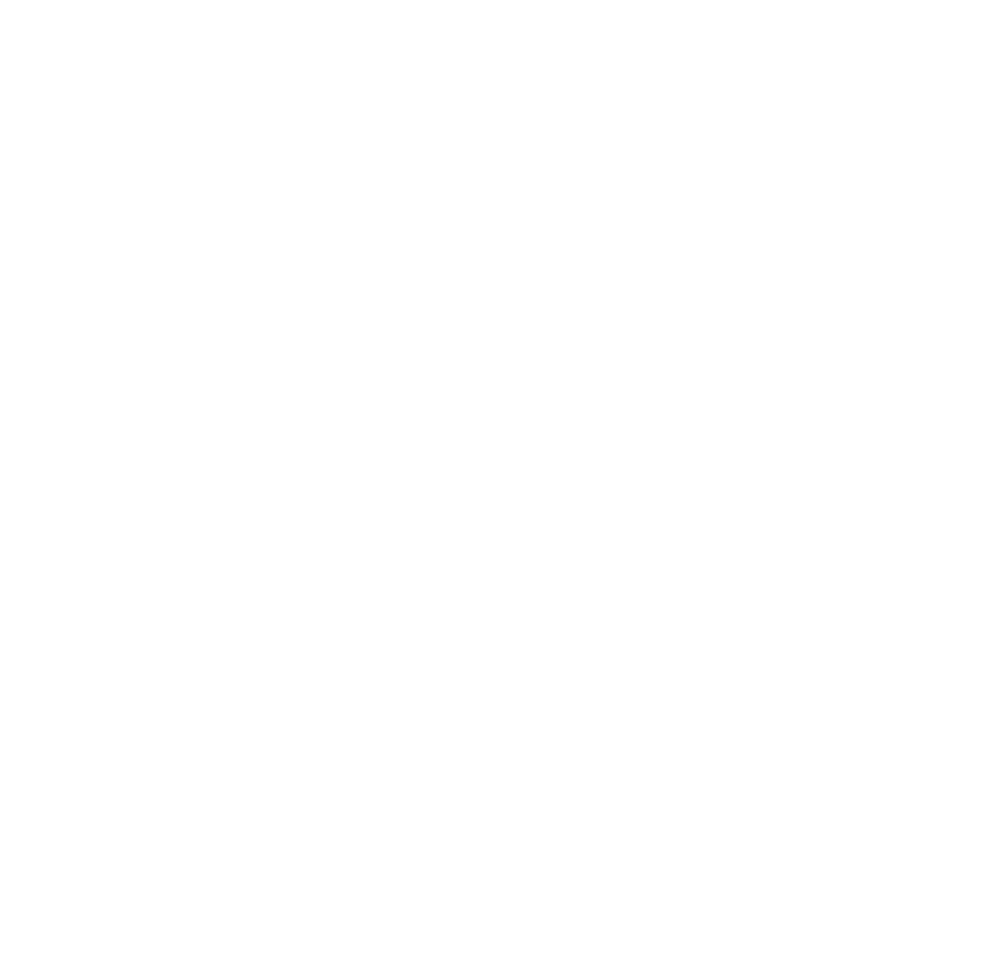

In [50]:

fig, ax = plt.subplots(figsize=(35, 35))

# Set the figure background to transparent
fig.patch.set_alpha(0)

# Remove the x and y axis
ax.axis('off')

# Loop through the umap_embedding, labels, and images
for i, (coord, label, orig_image) in enumerate(zip(umap_embedding, test_labels, test_orig_images)):
    x, y = coord[0] * (grid_size * 200), coord[1] * (grid_size * 200)

    img = orig_image
    filename = os.path.basename(image_paths[i])

    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Set the x and y limits
ax.set_xlim(0, grid_size * 200)
ax.set_ylim(0, grid_size * 200)

# Show the plot
plt.show()

/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/788484895.py:28: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


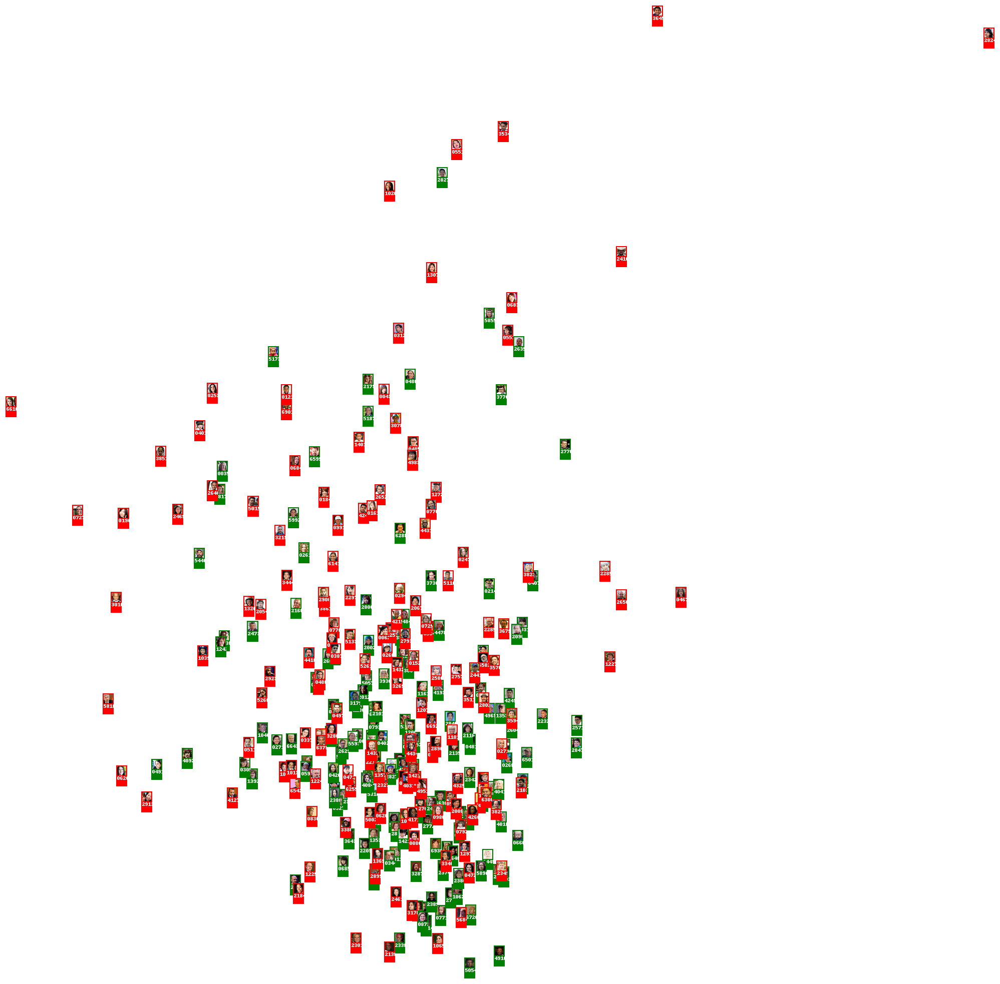

In [52]:
from sklearn.decomposition import PCA

# Use PCA to reduce the dimensionality of the features
pca = PCA(n_components=2, random_state=42)
embedding = pca.fit_transform(features)

# Normalize the coordinates between 0 and 1
normalized_embedding = (embedding - embedding.min(axis=0)) / (embedding.max(axis=0) - embedding.min(axis=0))

# Create the figure and axes objects
fig, ax = plt.subplots(figsize=(35, 35))

# Set the figure background to transparent
fig.patch.set_alpha(0)
scale_factor = 0.1
border_thickness = 2
# Remove the x and y axis
ax.axis('off')

# Loop through the normalized_embedding, labels, and images
for i, (coord, label, orig_image) in enumerate(zip(normalized_embedding, test_labels, test_orig_images)):
    x, y = coord[0] * (grid_size * 200), coord[1] * (grid_size * 200)

    img = orig_image
    filename = os.path.basename(image_paths[i])

    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Set the x and y limits
ax.set_xlim(0, grid_size * 200)
ax.set_ylim(0, grid_size * 200)

# Show the plot
plt.show()


/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/2325347466.py:26: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


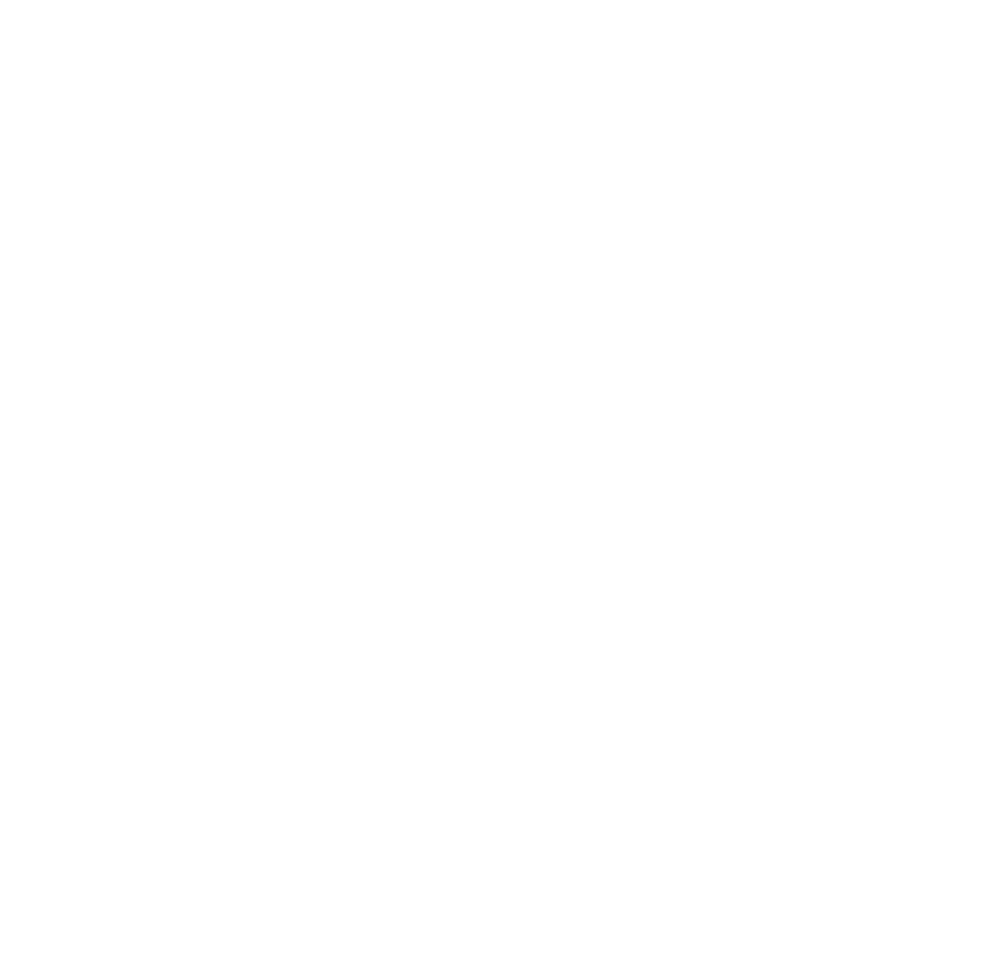

In [53]:
from sklearn.manifold import TSNE

# Use t-SNE to reduce the dimensionality of the features
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, n_iter=1000, random_state=42)
embedding = tsne.fit_transform(features)

# Normalize the coordinates between 0 and 1
normalized_embedding = (embedding - embedding.min(axis=0)) / (embedding.max(axis=0) - embedding.min(axis=0))

fig, ax = plt.subplots(figsize=(35, 35))

# Set the figure background to transparent
fig.patch.set_alpha(0)

# Remove the x and y axis
ax.axis('off')

# Loop through the normalized_embedding, labels, and images
for i, (coord, label, orig_image) in enumerate(zip(normalized_embedding, test_labels, test_orig_images)):
    x, y = coord[0] * (grid_size * 200), coord[1] * (grid_size * 200)

    img = orig_image
    filename = os.path.basename(image_paths[i])

    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    border_color = 'red' if label == 1 else 'green'
    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Show the plot
plt.show()


In [56]:
# Select the first 300 images
image_paths = image_paths[:306]

# Load the selected images from S3 and preprocess them for the RestNet model
test_images = []
for path in image_paths:
    img_obj = s3.Object(bucket_name, path)
    img = Image.open(img_obj.get()['Body'])
    img = img.resize(image_size, Image.ANTIALIAS)
    img = np.array(img)
    img = img / 255.0
    test_images.append(img)


test_images = np.stack(test_images)
test_orig_images = (test_images * 255).astype(np.uint8)

/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/3126708550.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img = img.resize(image_size, Image.ANTIALIAS)


In [57]:
# Create a custom model to extract features from the original model
# Assuming you want to extract features from the last layer before the output layer
feature_layer_index = -2

feature_extractor_model = tf.keras.Model(inputs=model.input, outputs=model.layers[feature_layer_index].output)
layer_outputs = [layer.output for layer in feature_extractor_model.layers]
feature_map_model = tf.keras.models.Model(inputs=feature_extractor_model.input, outputs=layer_outputs)
feature_maps = feature_map_model.predict(X)

ValueError: Graph disconnected: cannot obtain value for tensor KerasTensor(type_spec=TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float32, name='input_1'), name='input_1', description="created by layer 'input_1'") at layer "conv1_pad". The following previous layers were accessed without issue: []

/var/folders/y2/rmtghvx11dsdnn88ldv2d4w00000gn/T/ipykernel_55599/3680412560.py:85: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)


(3.7973073005676268, 9.439164352416991)

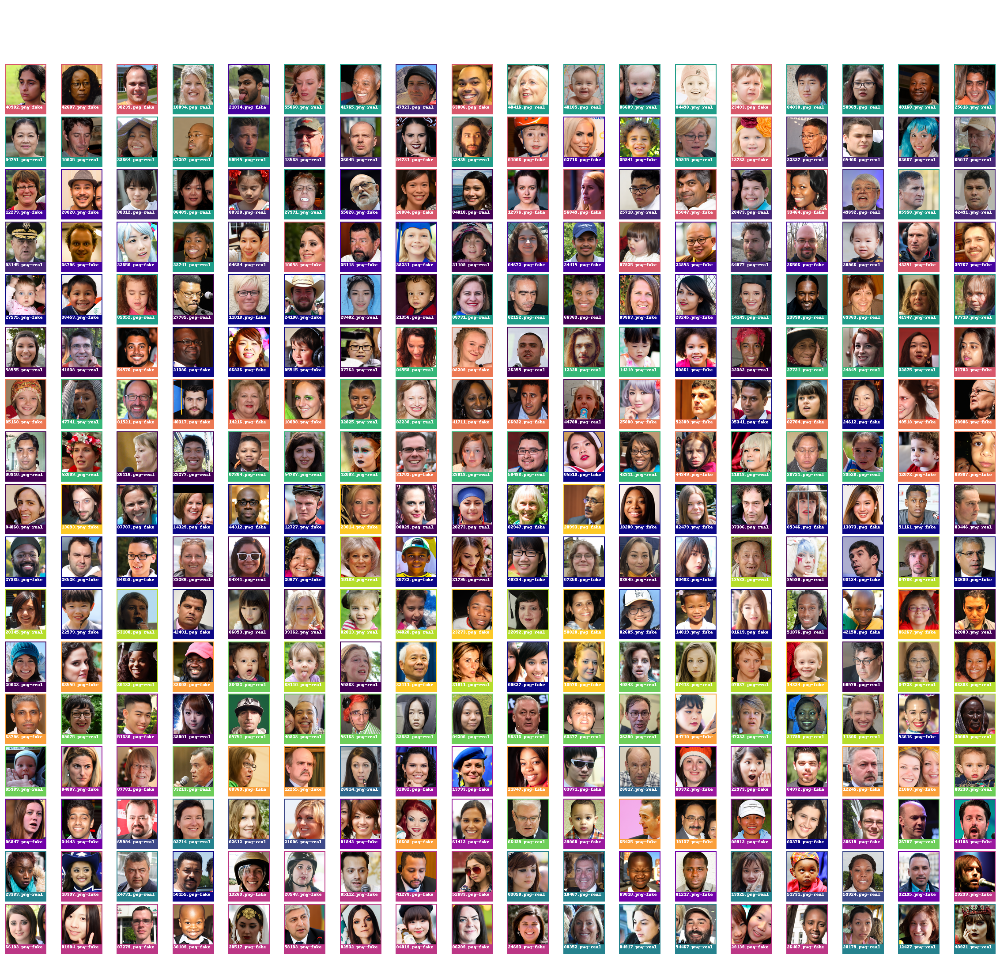

In [66]:
import numpy as np
from pyqtree import Index
import matplotlib.pyplot as plt
import matplotlib.offsetbox as offsetbox
import os
from PIL import Image, ImageDraw
import csv
import hdbscan

# Cluster the UMAP features using HDBSCAN
clusterer = hdbscan.HDBSCAN(min_cluster_size=10, min_samples=5)
cluster_labels = clusterer.fit_predict(umap_features)

# fig, ax = plt.subplots(figsize=(40, 40))
# # Define the scale factor and border thickness for displaying the images in the UMAP plot
# scale_factor = 0.6
# border_thickness = 2

fig, ax = plt.subplots(figsize=(40, 40))

# Set the figure background to transparent
fig.patch.set_alpha(0)

# Remove the x and y axis
ax.axis('off')

# Set the scale factor, border thickness and grid size
scale_factor = 0.5
border_thickness = 2

# Sort the images by their UMAP coordinates
sorted_indices = np.lexsort((umap_features[:, 1], umap_features[:, 0]))

# Initialize a list to store the image filenames and labels
image_data = []

# Calculate the number of rows and columns for the grid
n_rows = int(np.ceil(np.sqrt(len(umap_features))))
n_columns = n_rows

# Calculate the range of x and y coordinates
x_range = umap_features[:, 0].max() - umap_features[:, 0].min()
y_range = umap_features[:, 1].max() - umap_features[:, 1].min()

# Calculate the spacing between images in the grid
x_spacing = x_range / (n_columns - 1)
y_spacing = y_range / (n_rows - 1)

# Initialize the grid
grid = np.zeros((n_rows, n_columns))

# Define separate colors for real and fake images
colors_real = plt.cm.get_cmap('viridis', len(np.unique(cluster_labels)))
colors_fake = plt.cm.get_cmap('plasma', len(np.unique(cluster_labels)))


# Loop through the sorted images and place them in the grid
# Loop through the sorted images and place them in the grid
for i, index in enumerate(sorted_indices):
    # Get the filename and label for the current image
    filename = os.path.basename(image_paths[index])
    label = test_labels[index]

    # Add the image data to the list
    image_data.append([filename, label])
    
    row = i // n_columns
    column = i % n_columns

    # Calculate the x and y coordinates for the current image
    x = umap_features[:, 0].min() + column * x_spacing
    y = umap_features[:, 1].min() + row * y_spacing

    # Load and resize the image
    img = test_orig_images[index]

    # Get the filename and label for the current image
    filename = os.path.basename(image_paths[index])
    label = test_labels[index]

    # Create the border text
    border_text = f"{filename}-{'fake' if label == 1 else 'real'}"

    # Create the bordered image with text
    img_resized = Image.fromarray(img).resize((int(img.shape[0] * scale_factor), int(img.shape[1] * scale_factor)), Image.ANTIALIAS)
    # Change the border color according to the cluster label
        # Change the border color according to the cluster label and real/fake status
    if label == 0:  # Real
        border_color = tuple(int(c * 255) for c in colors_real(cluster_labels[index])[:3])
    else:  # Fake
        border_color = tuple(int(c * 255) for c in colors_fake(cluster_labels[index])[:3])


    bordered_image = Image.new('RGB', (img_resized.width + 2 * border_thickness, img_resized.height + 2 * border_thickness + 20), border_color)
    bordered_image.paste(img_resized, (border_thickness, border_thickness))
    draw = ImageDraw.Draw(bordered_image)
    draw.text((border_thickness, img_resized.height + border_thickness), border_text, fill="white")

    # Add the image to the plot
    imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(bordered_image), (x, y), frameon=False)
    ax.add_artist(imagebox)

# Save the image filenames and labels to a CSV file
csv_filename = "image_filenames.csv"
with open(csv_filename, mode="w", newline="") as csvfile:
    csv_writer = csv.writer(csvfile)
    csv_writer.writerow(["image_filename", "label"])
    csv_writer.writerows(image_data)

# # Set the plot limits and display the plot
ax.set_xlim(umap_features[:, 0].min() - 0.2, umap_features[:, 0].max() + 0.2)
ax.set_ylim(umap_features[:, 1].min() - 0.2, umap_features[:, 1].max() + 0.2)

# # Set the x and y limits
# ax.set_xlim(0, grid_size * 200)
# ax.set_ylim(0, grid_size * 200)
